### Bringing Object Detection and Distance Estimation together

### Add Paths

In [1]:
WORKSPACE_PATH = './workspace'
SCRIPTS_PATH = WORKSPACE_PATH+'/scripts'
APIMODEL_PATH = './models'
RESEARCH_PATH = APIMODEL_PATH+'/research'
OBJDETECTION_PATH = RESEARCH_PATH+'/object_detection'
ANNOTATION_PATH = WORKSPACE_PATH+'/annotations'
OBJECT_IMAGE_PATH = WORKSPACE_PATH+'/object_detection_images'
MODEL_PATH = WORKSPACE_PATH+'/models'
PRETRAINED_MODEL_PATH = WORKSPACE_PATH+'/pre-trained-models'
EXPORTEDMODEL_PATH = WORKSPACE_PATH+'/exported-models'

### Use the name of the exported object detection model

In [2]:
CUSTOM_MODEL_NAME = input()

ssd_resnet152_v1_fpn_1024x1024


### Import the DisNet model

In [3]:
from keras.models import model_from_json
# load json and create model
json_file = open('DisNet_model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
DisNet_model = model_from_json(loaded_model_json)
# load weights into new model
DisNet_model.load_weights("DisNet_model.h5")
print("Loaded model from disk")

2021-08-23 09:29:18.232322: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-08-23 09:29:44.086524: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-08-23 09:29:45.521101: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-23 09:29:45.522134: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1650 computeCapability: 7.5
coreClock: 1.56GHz coreCount: 16 deviceMemorySize: 3.82GiB deviceMemoryBandwidth: 119.24GiB/s
2021-08-23 09:29:45.522257: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-08-23 09:29:45.785827: I tensorflow/stream_executor/platform/

Loaded model from disk


In [4]:
DisNet_model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 100)               800       
_________________________________________________________________
dense_11 (Dense)             (None, 100)               10100     
_________________________________________________________________
dense_12 (Dense)             (None, 100)               10100     
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 101       
Total params: 21,101
Trainable params: 21,101
Non-trainable params: 0
_________________________________________________________________


### Object Properties

In [10]:
object_classes = {'Pedestrian':1,
                'Crosswalk':2,
                'Bike':3,
                'Car':4, 
                'Truck':5,
                'GreenLight':6,
                'GreenTrafficLight':7,
                'RedLight':8,
                'RedTrafficLight':9,
                'Bus':10}

object_height = {'Car': 160, 'Pedestrian': 175, 'Bike': 105, 'Bus': 299, 'Truck': 410, 'GreenLight': 120, 'GreenTrafficLight': 120, 'RedLight': 120, 'RedTrafficLight': 120, 'Crosswalk': 20}
object_width = {'Car': 180, 'Pedestrian': 55, 'Bike': 42, 'Bus': 255, 'Truck': 260, 'GreenLight': 40, 'GreenTrafficLight': 40, 'RedLight': 40, 'RedTrafficLight': 40, 'Crosswalk': 375}
object_breadth = {'Car': 400, 'Pedestrian': 30, 'Bike': 175, 'Bus': 1195, 'Truck': 1400, 'GreenLight': 50, 'GreenTrafficLight': 50, 'RedLight': 50, 'RedTrafficLight': 50, 'Crosswalk': 937}

object_list = ['Car', 'Pedestrian', 'Bike', 'GreenLight', 'GreenTrafficLight', 'RedLight', 'RedTrafficLight', 'Crosswalk'] 
distance_list = [16, 32, 48, 64, 80, 96]

### Inference on sample data

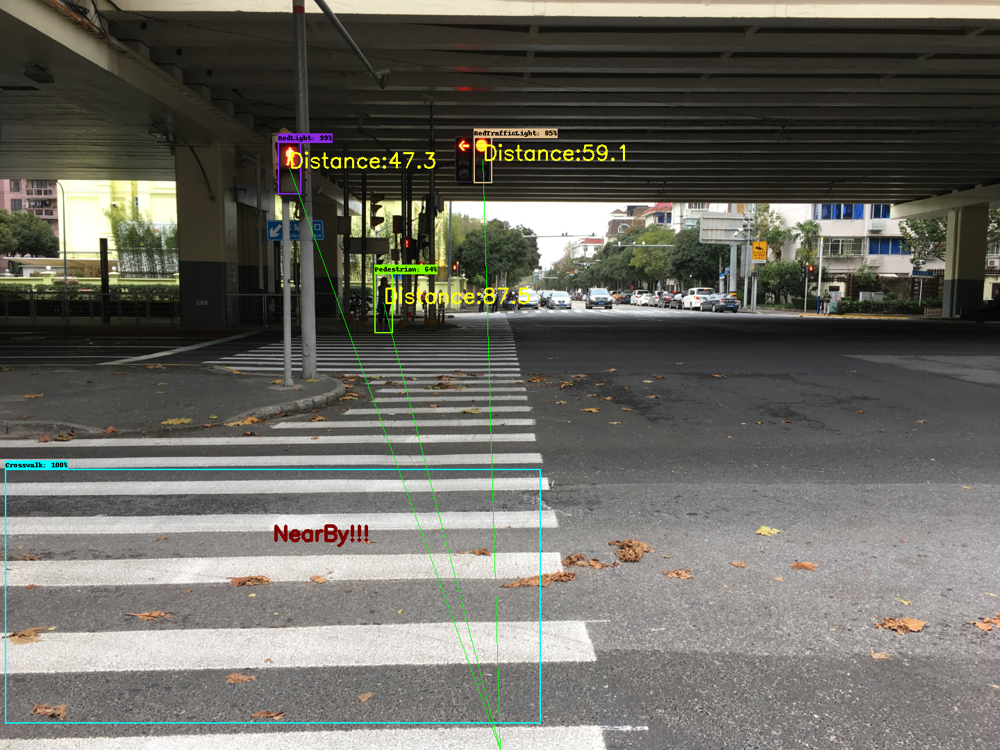

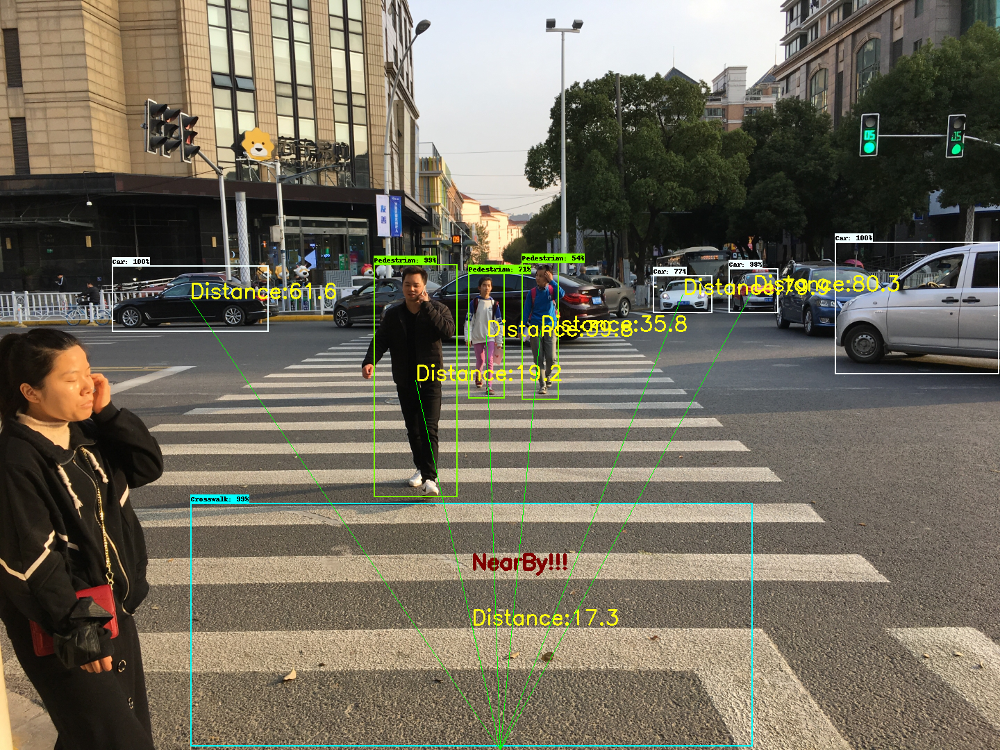

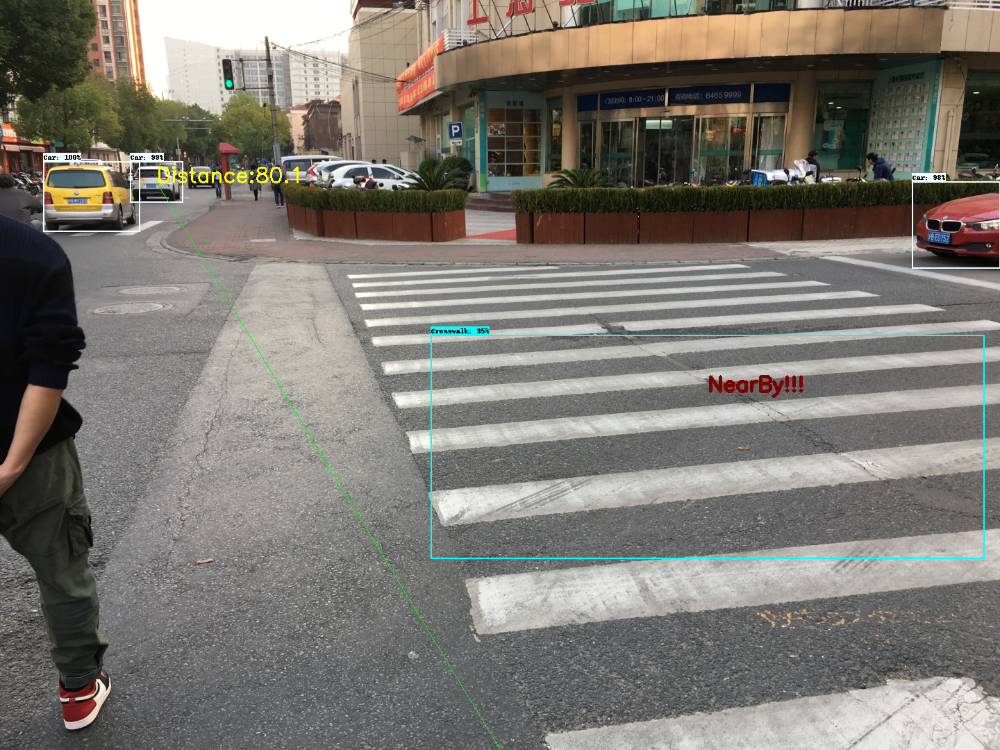

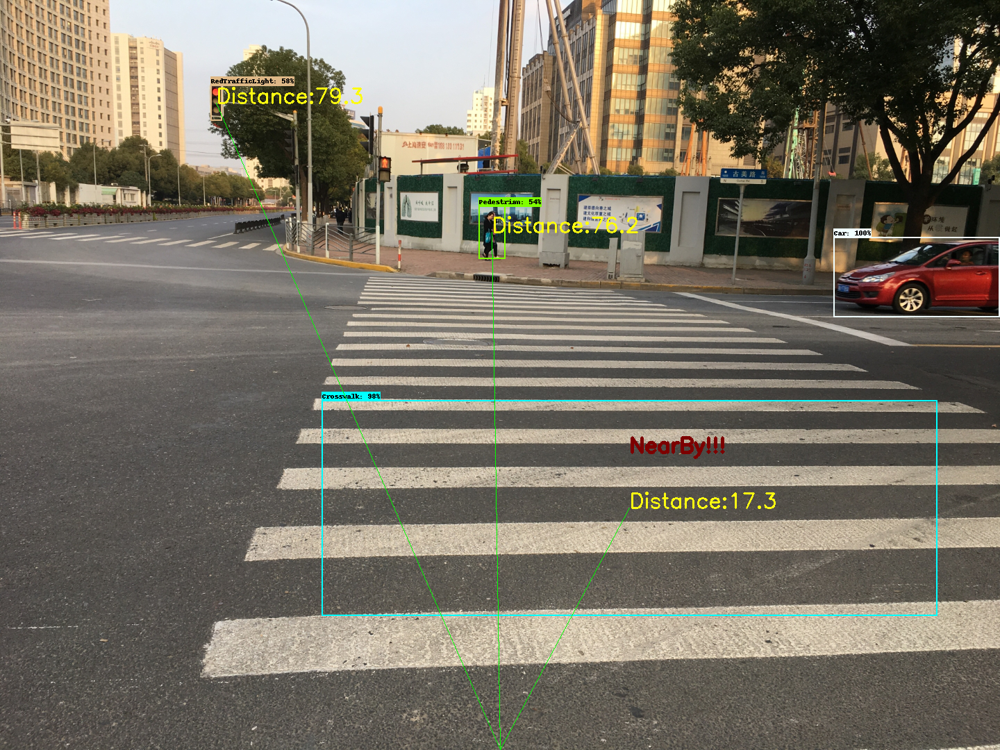

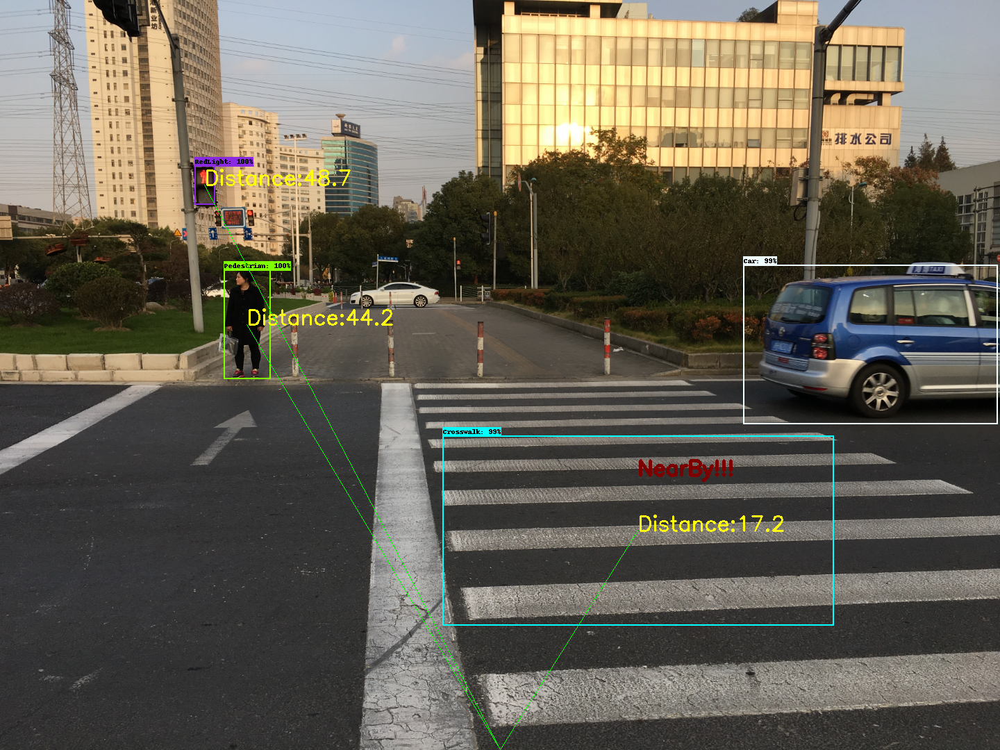

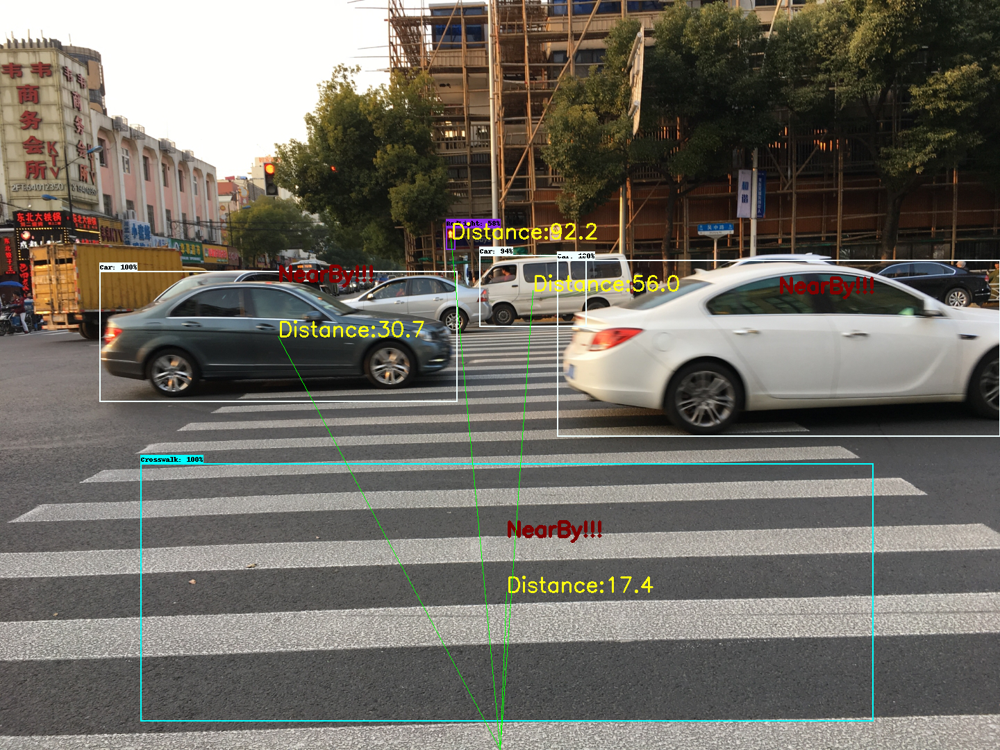

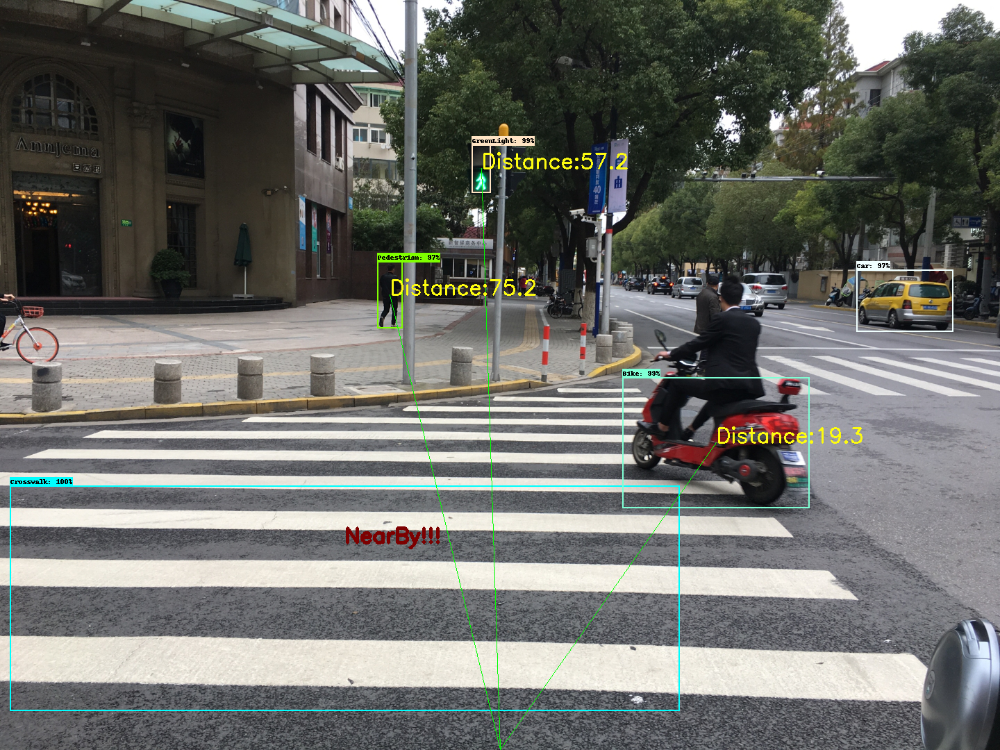

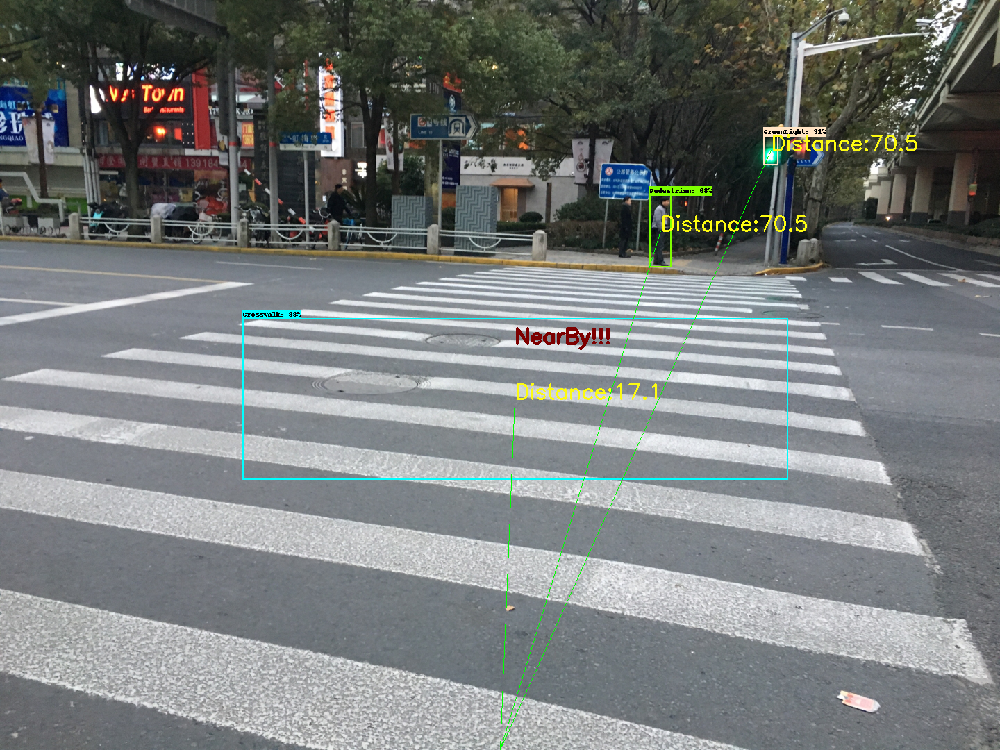

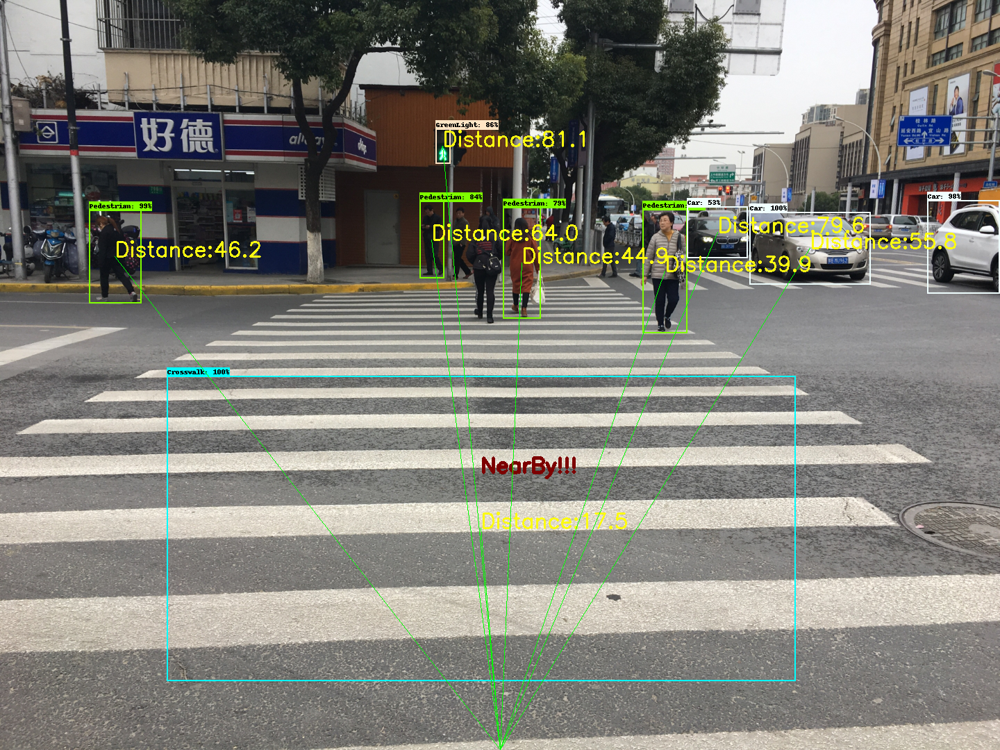

In [18]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
import cv2
import math
import tensorflow as tf
import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display
from six import BytesIO
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util
from results_to_audio import *

%matplotlib inline

def load_image_into_numpy_array(path):
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

category_index = label_map_util.create_category_index_from_labelmap(ANNOTATION_PATH+'/label_map.pbtxt')

tf.keras.backend.clear_session()
model = tf.saved_model.load(EXPORTEDMODEL_PATH+'/'+CUSTOM_MODEL_NAME+'/saved_model')

def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  input_tensor = tf.convert_to_tensor(image)
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  if 'detection_masks' in output_dict:
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

TESTIMAGES_FULLPATH = os.path.abspath("./workspace/mobility_assistant_images")

for image_path in glob.glob(TESTIMAGES_FULLPATH+'/*.JPG'):
    image_np = load_image_into_numpy_array(image_path)
    output_dict = run_inference_for_single_image(model, image_np)
    vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      min_score_thresh=0.5,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=2
    )
    
    boxes = output_dict['detection_boxes']
    scores = output_dict['detection_scores']
    min_score_thresh=0.5
    
    image_width = image_np.shape[1]
    image_height = image_np.shape[0]
    
    # iterate over all objects found
    for i,b in enumerate(boxes):
        
        if scores[i] >= min_score_thresh:
            
            partition = int(image_np.shape[1]/3) # width / 3
            
            class_name = category_index[output_dict['detection_classes'][i]]['name']

            x_max_coord = boxes[i][3]
            x_max = x_max_coord*image_width
            x_min_coord = boxes[i][1]
            x_min = x_min_coord*image_width
            y_max_coord = boxes[i][2]
            y_max = y_max_coord*image_height
            y_min_coord = boxes[i][0]
            y_min = y_min_coord*image_height
            
            mid_x = (boxes[i][1]+boxes[i][3])/2
            mid_y = (boxes[i][0]+boxes[i][2])/2
            
            features_list = []
            
            if (class_name != 'Bus' or class_name != 'Truck'): 

                # class number
                features_list.append(object_classes[class_name])
                # 1/Bh
                features_list.append(1/((y_max-y_min)/image_height))
                # 1/Bw
                features_list.append(1/((x_max-x_min)/image_width))
                # 1/Bd - math.sqrt(FRAME_WIDTH ** 2 + FRAME_HEIGHT ** 2 )
                features_list.append(1/((math.sqrt((x_max-x_min)**2+(y_max-y_min)**2))/(math.sqrt(image_width**2+image_height**2))))
                # Ch
                features_list.append(object_height[class_name])
                # Cw
                features_list.append(object_width[class_name])
                # Cb
                features_list.append(object_breadth[class_name])            

                features_list =  np.array([features_list])

                distance = DisNet_model.predict(features_list)[0][0]

                # find nearby objects
                apx_distance = round(((1 - (boxes[i][3] - boxes[i][1]))**4),4)
                if apx_distance <= 0.2:
                    
                    cv2.putText(image_np, 'NearBy!!!', (int(mid_x*image_width),int(mid_y*image_height)-80), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (125,0,0), 3)
                    if 0 <= int(mid_x*image_width) <= partition:
                        position_obj = 'left'
                    if partition < int(mid_x*image_width) <= (partition+partition):
                        position_obj = 'front'
                    if (partition+partition) < int(mid_x*image_width) <= image_np.shape[1]: 
                        position_obj = 'right'
                    string = "{} is on your {}, at a distance of {} feet.".format(class_name,position_obj,int(distance))

                    try:
                        given_string_to_audio_ibm_watson(string) # since ibm_watson is limited
                    except: 
                        given_string_to_audio_gtts(string) # use gtts if the daily limit is exceeded

            # if object is detected in the corners (cropped object) than skip
            if (image_width*0.05) < int(boxes[i][1]*image_width) < (image_width*0.95) and (image_width*0.05) < (boxes[i][3]*image_width) < (image_width*0.95):
                
                cv2.putText(image_np, 'Distance:{:.1f}'.format(distance), (int(mid_x*image_width),int(mid_y*image_height)), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (252,251,17), 2)

                cv2.line(image_np, (int(mid_x*image_width),int(mid_y*image_height)),(int(image_width/2),image_height), color = (0, 255, 0), thickness=1)


    display(Image.fromarray(image_np))